In [206]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import altair as alt
import nltk
import numpy as np
import matplotlib.pyplot as plt

from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.dummy import DummyClassifier
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.model_selection import (
    GridSearchCV,
    RandomizedSearchCV,
    cross_val_score,
    cross_validate,
    train_test_split,
)
from sklearn.impute import SimpleImputer
from collections import Counter
from sklearn.feature_extraction import DictVectorizer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, StackingClassifier
from xgboost import XGBClassifier
from lightgbm.sklearn import LGBMClassifier
from catboost import CatBoostClassifier
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
from scipy.stats import lognorm, loguniform, randint
from collections import Counter


# nltk.download('stopwords')

In [3]:
from feature_extractions_helper import *

In [4]:
df = pd.read_csv("data/processed/processed_data_7760.csv", index_col=0)

In [5]:
df.head()

,created_at,id,full_text,entities,is_quote_status,retweet_count,favorite_count,possibly_sensitive,keyword,location,...,tags_count,cap_words_count,slang_acronym_count,sentence_count,avg_pos_words,avg_neg_words,avg_slang_sent,avg_len_sent,avg_len_tokens,processed_text
0,Mon Dec 21 17:31:03 +0000 2020,1.341074e+18,Today we add an important chapter to a Europea...,"['COVID19', 'EUvaccinationdays']",False,1557.0,5840.0,False,Covid19 vaccine,NaN,...,"(9, 3, 0, 0)",2,0,2,0.086957,0.0,-0.025641,20.000000,4.850000,today we add an important chapter to a europea...
1,Tue Dec 22 20:20:16 +0000 2020,1.341479e+18,Sedgwick County has received its first allocat...,['COVID19'],False,9.0,50.0,False,Covid19 vaccine,"Sedgwick County, Kansas",...,"(8, 6, 0, 1)",2,0,2,0.000000,0.0,0.000000,19.000000,5.421053,sedgwick county ha receive it first allocation...
2,Wed Dec 23 00:32:16 +0000 2020,1.341542e+18,Now is not the time to let up. Vaccines are he...,['COVID19'],False,0.0,0.0,False,Covid19 vaccine,Southern California,...,"(13, 2, 4, 0)",1,0,2,0.020000,0.0,0.023256,21.500000,4.720930,now be not the time to let up vaccine be here ...
3,Tue Dec 22 16:34:35 +0000 2020,1.341422e+18,I received my #COVID19 vaccination today. It w...,['COVID19'],False,139.0,1008.0,False,Covid19 vaccine,NaN,...,"(10, 1, 2, 0)",3,0,3,0.083333,0.0,0.000000,14.333333,4.627907,i receive my covid vaccination today it wa gre...
4,Sat Dec 19 18:58:07 +0000 2020,1.340371e+18,. Gen. Gus Perna on the distribution of the Mo...,['COVID19'],False,325.0,1784.0,False,Covid19 vaccine,"The Pentagon, Washington, D.C.",...,"(2, 5, 0, 0)",1,0,4,0.000000,0.0,0.000000,3.750000,4.642857,gen gu perna on the distribution of the modern...


## Data Splitting

In [6]:
train_df, test_df = train_test_split(df, test_size = 0.2, random_state=123)

In [7]:
print(train_df.shape)
print(test_df.shape)

(6208, 33)
(1552, 33)


## EDA

In [8]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6208 entries, 7461 to 3582
Data columns (total 33 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   created_at                6208 non-null   object 
 1   id                        6208 non-null   float64
 2   full_text                 6208 non-null   object 
 3   entities                  6208 non-null   object 
 4   is_quote_status           6208 non-null   bool   
 5   retweet_count             6208 non-null   float64
 6   favorite_count            6208 non-null   float64
 7   possibly_sensitive        3835 non-null   object 
 8   keyword                   6208 non-null   object 
 9   location                  4686 non-null   object 
 10  hashtags_count            6208 non-null   float64
 11  city                      2733 non-null   object 
 12  province                  2292 non-null   object 
 13  country                   3866 non-null   object 
 14  senti

<AxesSubplot:>

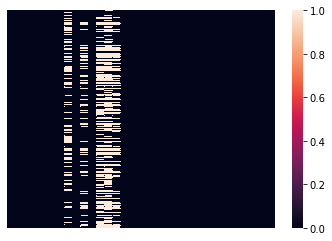

In [9]:
sns.heatmap(train_df.isna(), xticklabels=False, yticklabels=False)

In [10]:
alt.data_transformers.disable_max_rows()
alt.Chart(train_df).mark_bar().encode(
    alt.X("sentiment", title="Tweet sentiment"),
    alt.Y("count()", title="Number of tweets")
).properties(title="Number of tweets across all sentiments", width=200)

alt.Chart(...)

In [11]:
alt.Chart(train_df).mark_bar().encode(
    alt.X("country", title="Counrty", sort='-y'),
    alt.Y("count(sentiment)", title="Number of tweets"),
).properties(title="Number of tweets across all countries")

alt.Chart(...)

In [12]:
country_majority = train_df.query("country in ['United States', 'United Kingdom', 'Canada', 'India']")
alt.Chart(country_majority).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("sentiment", title="Tweet sentiment"),
).properties(height=80).facet(row="country")

alt.FacetChart(...)

In [13]:
subset_usa = train_df[train_df["country"] == "United States"]
alt.Chart(subset_usa).mark_bar().encode(
    alt.X("province", title="USA Province code", sort="-y"),
    alt.Y("count(sentiment)", title="Number of tweets")
).properties(title="Number of tweets across all provinces in USA")

alt.Chart(...)

In [14]:
alt.Chart(subset_usa.query("province in ['NY', 'CA', 'DC']")).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("sentiment", title="Tweet sentiment"),
).properties(height=80).facet(row="province")

alt.FacetChart(...)

<AxesSubplot:>

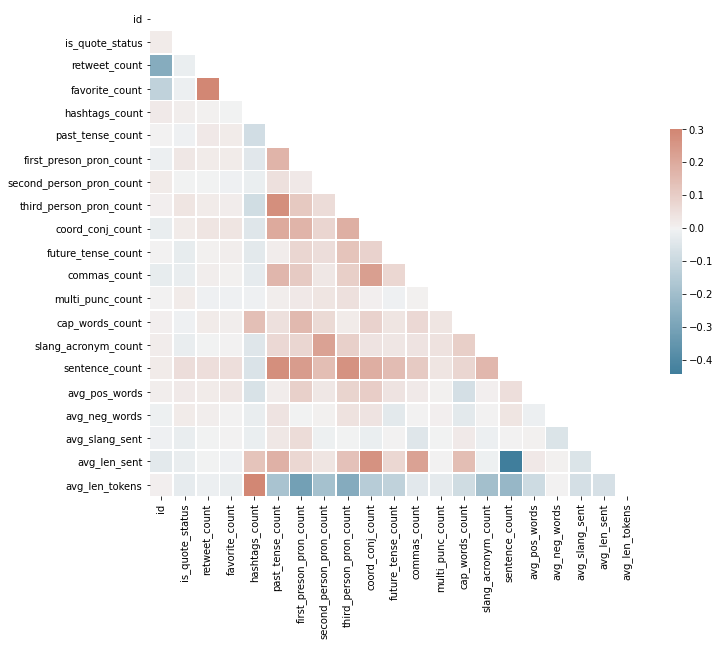

In [15]:
# Compute the correlation matrix
corr = train_df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [16]:
numeric_cols = train_df.select_dtypes('number').drop(columns=[
    'id','retweet_count', 'favorite_count']).columns.tolist()

(alt.Chart(train_df).mark_bar().encode(
    alt.X(alt.repeat(), type='quantitative', bin=alt.Bin(maxbins=40)),
    y='count()',
    color="sentiment")
 .properties(height=80, width=200)
 .repeat(repeat=numeric_cols, columns=2))

alt.RepeatChart(...)

In [17]:
alt.Chart(train_df).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("keyword")
).properties(height=80).facet(row="keyword")

alt.FacetChart(...)

In [18]:
wc_stopwords = STOPWORDS | {"amp", "vaccine","vaccines", "covid 19", "covid", "covid19", "will", 'covid19 vaccine', 'pfizer', 'astrazeneca', 'moderna'}
wordcloud = WordCloud(background_color="white", max_words=2000, stopwords=wc_stopwords)

def generate_wordcloud(wordCloud, subset):
    sub_df = train_df[train_df["sentiment"] == subset]
    text = " ".join(sub_df.full_text).lower()
    wordcloud.generate(text)
    fig = plt.figure()
    fig.set_figwidth(14) # set width
    fig.set_figheight(18) # set height
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

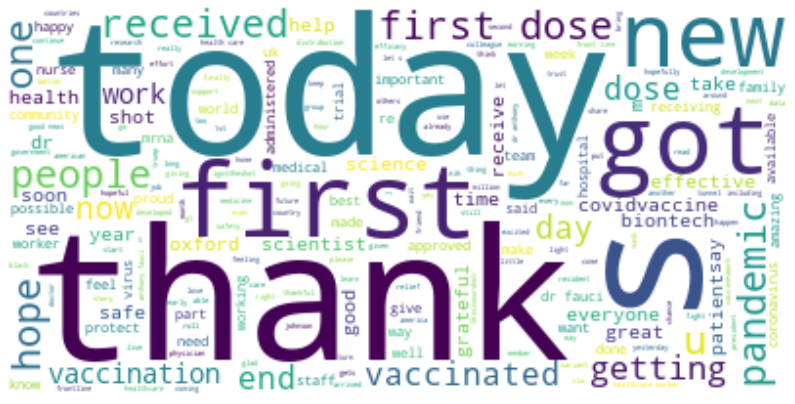

In [19]:
generate_wordcloud(wordcloud, "pos")

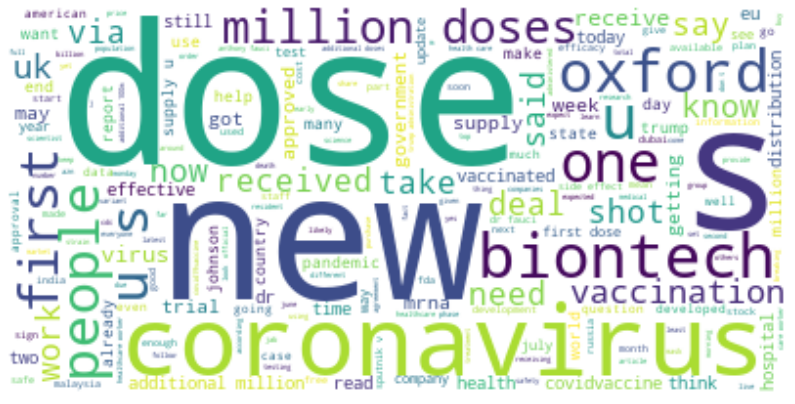

In [20]:
generate_wordcloud(wordcloud, "neu")

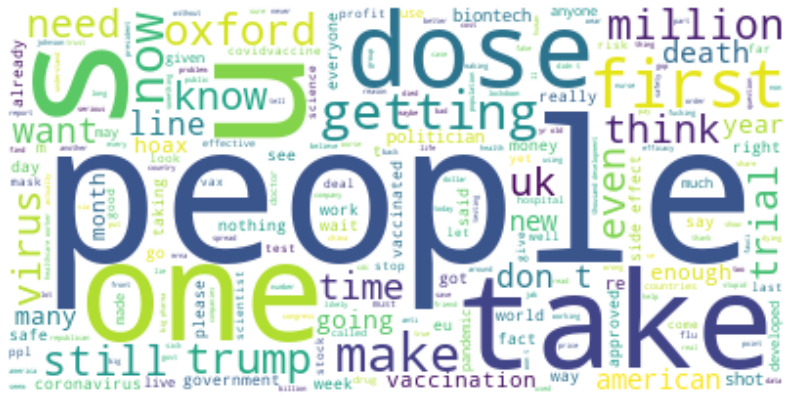

In [21]:
generate_wordcloud(wordcloud, "neg")

In [22]:
train_df.columns

Index(['created_at', 'id', 'full_text', 'entities', 'is_quote_status',
       'retweet_count', 'favorite_count', 'possibly_sensitive', 'keyword',
       'location', 'hashtags_count', 'city', 'province', 'country',
       'sentiment', 'past_tense_count', 'first_preson_pron_count',
       'second_person_pron_count', 'third_person_pron_count',
       'coord_conj_count', 'future_tense_count', 'commas_count',
       'multi_punc_count', 'tags_count', 'cap_words_count',
       'slang_acronym_count', 'sentence_count', 'avg_pos_words',
       'avg_neg_words', 'avg_slang_sent', 'avg_len_sent', 'avg_len_tokens',
       'processed_text'],
      dtype='object')

## Preprocessing

In [32]:
drop_features = ["created_at", "id", "entities", "is_quote_status", "location", "tags_count"] # I'll add tags_counts later
target = "sentiment"
categorical_features = ["keyword", "city", "province", "country"]
text_feature = "processed_text"

In [33]:
numeric_list = train_df.select_dtypes(include=np.number).columns.tolist()
numeric_set = set(numeric_list) - {"id"}
numeric_set.add("possibly_sensitive") # numeric feature
numeric_features = list(numeric_set)

In [34]:
# spliting X_train and y_train

X_train, y_train = train_df.drop(columns=drop_features).drop(columns=[target]), train_df[target]
X_test, y_test = test_df.drop(columns=drop_features).drop(columns=[target]), test_df[target]

In [143]:
# The scoring function is adapted from the lecture note of DSCI-573.
results = {}

def mean_std_cross_val_scores(model, X_train, y_train, **kwargs):
    """
    Returns mean and std of cross validation.
    """
    scores = cross_validate(model, X_train, y_train, **kwargs)

    mean_scores = pd.DataFrame(scores).mean()
    std_scores = pd.DataFrame(scores).std()
    out_col = []

    for i in range(len(mean_scores)):
        out_col.append((f"%0.3f (+/- %0.3f)" % (mean_scores[i], std_scores[i])))

    return pd.Series(data=out_col, index=mean_scores.index)

In [136]:
numeric_transformer = make_pipeline(SimpleImputer(strategy="median"),
                                    StandardScaler())
categorical_transformer = make_pipeline(SimpleImputer(strategy="constant", fill_value="missing"),
                                        OneHotEncoder(handle_unknown="ignore"))

preprocessor_non_bow = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features))
preprocessor_non_bow

ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 ['first_preson_pron_count',
                                  'second_person_pron_count',
                                  'third_person_pron_count', 'coord_conj_count',
                                  'sentence_count', 'avg_len_sent',
                                  'avg_neg_words', 'slang_acronym_count',
                                  'future_tense_count', 'favorite...
                                  'possibly_sensitive', 'past_tense_count',
                                  'avg_slang_sent', 'hashtags_count',
                                  'avg_len_tokens', 'avg_pos_words',
                                

In [144]:
dummy = make_pipeline(preprocessor_non_bow, DummyClassifier(strategy="most_frequent"))

results["dummy"] = mean_std_cross_val_scores(
    dummy, X_train, y_train, return_train_score=True
)
pipe_lr_non_bow = make_pipeline(
    preprocessor_non_bow,
    LogisticRegression(random_state=123, max_iter=2000)
)
results["LR+non_text"] = mean_std_cross_val_scores(
    pipe_lr_non_bow, X_train, y_train, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002)


#### Text representation: Bag of words

In [152]:
c = Counter(" ".join(train_df.processed_text).split())
c.most_common(10)

[('the', 8469),
 ('vaccine', 6005),
 ('be', 4950),
 ('to', 4448),
 ('covid', 3874),
 ('of', 3537),
 ('a', 3235),
 ('and', 2868),
 ('in', 2422),
 ('for', 1960)]

In [145]:
bow_preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features),
    (CountVectorizer(ngram_range=(1, 2), stop_words="english"), text_feature) # unigram and bigram
)
bow_preprocessor

ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 ['first_preson_pron_count',
                                  'second_person_pron_count',
                                  'third_person_pron_count', 'coord_conj_count',
                                  'sentence_count', 'avg_len_sent',
                                  'avg_neg_words', 'slang_acronym_count',
                                  'future_tense_count', 'favorite...
                                  'retweet_count', 'cap_words_count',
                                  'multi_punc_count', 'commas_count']),
                                ('pipeline-2',
                                 Pipeline(steps=[('simplei

In [146]:
X_train_enc = bow_preprocessor.fit_transform(X_train, y_train)

# vocabulary list 
vocab = bow_preprocessor.named_transformers_['countvectorizer'].vocabulary_

# getting feature names
num_features = numeric_features
ohe_features = bow_preprocessor.named_transformers_['pipeline-2']['onehotencoder'].get_feature_names().tolist()
vocab = bow_preprocessor.named_transformers_['countvectorizer'].get_feature_names()

enc_columns = num_features + ohe_features + vocab

# the number of features we have
len(enc_columns)

64784

In [147]:
pipe_bow_lr = make_pipeline(
    bow_preprocessor, LogisticRegression(random_state=123, max_iter=2000)
)
results["LR+BOW"] = mean_std_cross_val_scores(
    pipe_bow_lr, X_train, y_train, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text,Logistic Regression+BOW
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027),4.258 (+/- 0.365)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001),0.074 (+/- 0.010)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007),0.763 (+/- 0.009)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002),0.997 (+/- 0.001)


#### **Bag of words features improve the performance of logistic regression.**

#### Text representation: TF-IDF

In [148]:
# TF-IDF text representation
tfidf_preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features),
    (TfidfVectorizer(ngram_range=(1, 2), stop_words="english"), text_feature) # unigram and bigram
)
tfidf_preprocessor

ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 ['first_preson_pron_count',
                                  'second_person_pron_count',
                                  'third_person_pron_count', 'coord_conj_count',
                                  'sentence_count', 'avg_len_sent',
                                  'avg_neg_words', 'slang_acronym_count',
                                  'future_tense_count', 'favorite...
                                  'retweet_count', 'cap_words_count',
                                  'multi_punc_count', 'commas_count']),
                                ('pipeline-2',
                                 Pipeline(steps=[('simplei

In [149]:
# find features after preprocessing
X_train_enc = tfidf_preprocessor.fit_transform(X_train, y_train)
vocab = tfidf_preprocessor.named_transformers_['tfidfvectorizer'].vocabulary_

# getting feature names
num_features = numeric_features
tfidf_ohe_features = tfidf_preprocessor.named_transformers_['pipeline-2']['onehotencoder'].get_feature_names().tolist()
tfidf_vocab = tfidf_preprocessor.named_transformers_['tfidfvectorizer'].get_feature_names()

tf_idf_enc_columns = num_features + tfidf_ohe_features + tfidf_vocab
len(tf_idf_enc_columns)

64784

In [150]:
pipe_tfidf_lr = make_pipeline(
    tfidf_preprocessor, LogisticRegression(random_state=123, max_iter=2000)
)
results["LR+TFIDF"] = mean_std_cross_val_scores(
    pipe_tfidf_lr, X_train, y_train, return_train_score=True
)
pd.DataFrame(results)

,dummy,LR+non_text,Logistic Regression+BOW,LR+TFIDF
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027),4.258 (+/- 0.365),5.305 (+/- 0.147)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001),0.074 (+/- 0.010),0.079 (+/- 0.005)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007),0.763 (+/- 0.009),0.757 (+/- 0.006)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002),0.997 (+/- 0.001),0.890 (+/- 0.001)


#### **Bag of words perform better than TFIDF on this task.**

#### Hyperparamter on BOW

In [163]:
param_grid = {
    "columntransformer__countvectorizer__max_features": np.arange(50, len(enc_columns)),
    "columntransformer__countvectorizer__max_df": np.arange(10000, 70000, 5000),
    "columntransformer__countvectorizer__min_df": np.arange(1, 10),
}

random_search = RandomizedSearchCV(
    pipe_bow_lr,
    param_grid,
    n_iter=30,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    return_train_score=True,
)

random_search.fit(X_train, y_train);

Fitting 5 folds for each of 30 candidates, totalling 150 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    8.0s
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:   43.1s finished


In [164]:
random_search.best_score_

0.7553134257475076

**BOW performs best when using default hyperparameters.**

## Linear Models

### Logistic Regression + Hyperparameter Tuning

In [154]:
param_grid = {"logisticregression__C": loguniform(1e-4, 1e4)}

random_search = RandomizedSearchCV(
    pipe_bow_lr,
    param_grid,
    n_iter=30,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    return_train_score=True,
)

random_search.fit(X_train, y_train);

Fitting 5 folds for each of 30 candidates, totalling 150 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:  6.3min finished


In [156]:
random_search.best_score_

0.7638512912940969

**There's no improvement when tuning C, so keep the default value.**

## Non-linear Models

#### Classification + Ensembles

In [187]:
pipe_rf = make_pipeline(
    bow_preprocessor, RandomForestClassifier(random_state=123)
)
pipe_xgb = make_pipeline(
    bow_preprocessor, XGBClassifier(random_state=123)
)
pipe_lgbm = make_pipeline(
    bow_preprocessor, LGBMClassifier(random_state=123)
)
pipe_cat = make_pipeline(bow_preprocessor, CatBoostClassifier(random_state=123, verbose=0))
pipe_svc = make_pipeline(bow_preprocessor, SVC(random_state=123))
pipe_dt = make_pipeline(bow_preprocessor, DecisionTreeClassifier(random_state=123))


classifiers = {
    "Random Forest": pipe_rf,
    "XGBoost": pipe_xgb,
    "LGBM": pipe_lgbm,
    "SVM_RBF": pipe_svc,
    "Decision Tree": pipe_dt,
    "CatBoost": pipe_cat
}

In [183]:
for name, model in classifiers.items():
    results[name] = mean_std_cross_val_scores(model, X_train, y_train, return_train_score=True)


Learning rate set to 0.085866
0:	learn: 1.0506160	total: 231ms	remaining: 3m 50s
1:	learn: 1.0142606	total: 417ms	remaining: 3m 28s
2:	learn: 0.9794217	total: 601ms	remaining: 3m 19s
3:	learn: 0.9476099	total: 781ms	remaining: 3m 14s
4:	learn: 0.9269421	total: 957ms	remaining: 3m 10s
5:	learn: 0.9059895	total: 1.13s	remaining: 3m 7s
6:	learn: 0.8871204	total: 1.31s	remaining: 3m 5s
7:	learn: 0.8719438	total: 1.48s	remaining: 3m 3s
8:	learn: 0.8574333	total: 1.65s	remaining: 3m 2s
9:	learn: 0.8452033	total: 1.82s	remaining: 3m
10:	learn: 0.8310589	total: 1.99s	remaining: 2m 58s
11:	learn: 0.8202039	total: 2.15s	remaining: 2m 57s
12:	learn: 0.8097030	total: 2.32s	remaining: 2m 56s
13:	learn: 0.8021331	total: 2.49s	remaining: 2m 55s
14:	learn: 0.7956809	total: 2.66s	remaining: 2m 54s
15:	learn: 0.7881943	total: 2.83s	remaining: 2m 54s
16:	learn: 0.7819969	total: 3s	remaining: 2m 53s
17:	learn: 0.7759925	total: 3.16s	remaining: 2m 52s
18:	learn: 0.7720208	total: 3.33s	remaining: 2m 51s
19:

,dummy,LR+non_text,Logistic Regression+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,Naive Bayes,SVM_RBF,Decision Tree,CatBoost
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027),4.258 (+/- 0.365),5.305 (+/- 0.147),4.612 (+/- 0.184),5.285 (+/- 0.479),1.098 (+/- 0.080),0.278 (+/- 0.031),5.492 (+/- 0.118),1.655 (+/- 0.055),200.331 (+/- 10.213)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001),0.074 (+/- 0.010),0.079 (+/- 0.005),0.116 (+/- 0.009),0.128 (+/- 0.010),0.085 (+/- 0.007),0.000 (+/- 0.000),0.998 (+/- 0.018),0.045 (+/- 0.004),0.186 (+/- 0.022)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007),0.763 (+/- 0.009),0.757 (+/- 0.006),0.697 (+/- 0.005),0.760 (+/- 0.011),0.755 (+/- 0.007),nan (+/- nan),0.740 (+/- 0.005),0.664 (+/- 0.018),0.756 (+/- 0.008)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002),0.997 (+/- 0.001),0.890 (+/- 0.001),1.000 (+/- 0.000),0.931 (+/- 0.003),0.939 (+/- 0.001),nan (+/- nan),0.900 (+/- 0.003),1.000 (+/- 0.000),0.817 (+/- 0.002)


In [184]:
pd.DataFrame(results)

,dummy,LR+non_text,Logistic Regression+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,Naive Bayes,SVM_RBF,Decision Tree,CatBoost
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027),4.258 (+/- 0.365),5.305 (+/- 0.147),4.612 (+/- 0.184),5.285 (+/- 0.479),1.098 (+/- 0.080),0.278 (+/- 0.031),5.492 (+/- 0.118),1.655 (+/- 0.055),200.331 (+/- 10.213)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001),0.074 (+/- 0.010),0.079 (+/- 0.005),0.116 (+/- 0.009),0.128 (+/- 0.010),0.085 (+/- 0.007),0.000 (+/- 0.000),0.998 (+/- 0.018),0.045 (+/- 0.004),0.186 (+/- 0.022)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007),0.763 (+/- 0.009),0.757 (+/- 0.006),0.697 (+/- 0.005),0.760 (+/- 0.011),0.755 (+/- 0.007),nan (+/- nan),0.740 (+/- 0.005),0.664 (+/- 0.018),0.756 (+/- 0.008)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002),0.997 (+/- 0.001),0.890 (+/- 0.001),1.000 (+/- 0.000),0.931 (+/- 0.003),0.939 (+/- 0.001),nan (+/- nan),0.900 (+/- 0.003),1.000 (+/- 0.000),0.817 (+/- 0.002)


**XGBoost and LGBM are two strong candidates.**

LGBM Hyperparameters Tuning

In [190]:
param_grid_lgbm = {
    "lgbmclassifier__n_estimators": randint(10, 200),
    "lgbmclassifier__learning_rate": [0.001, 0.01, 0.1],
    "lgbmclassifier__max_depth": randint(low=2, high=30),
    "lgbmclassifier__subsample": [0.5, 0.75, 1],
}

In [191]:
random_search_lgbm = RandomizedSearchCV(
    pipe_lgbm,
    param_grid_lgbm,
    n_iter=50,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    return_train_score=True,
)

random_search_lgbm.fit(X_train, y_train);

Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:   41.2s
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed:  1.1min finished


In [192]:
random_search_lgbm.best_score_

0.7606306793778328

In [194]:
random_search_lgbm.best_params_

{'lgbmclassifier__learning_rate': 0.1,
 'lgbmclassifier__max_depth': 17,
 'lgbmclassifier__n_estimators': 83,
 'lgbmclassifier__subsample': 0.5}

In [193]:
best_lgbm_model = random_search_lgbm.best_estimator_
results["LGBM (tuned)"] = mean_std_cross_val_scores(
    best_lgbm_model, X_train, y_train, return_train_score=True
)
pd.DataFrame(results)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


,dummy,LR+non_text,Logistic Regression+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,Naive Bayes,SVM_RBF,Decision Tree,CatBoost,LGBM (tuned)
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027),4.258 (+/- 0.365),5.305 (+/- 0.147),4.612 (+/- 0.184),5.285 (+/- 0.479),1.098 (+/- 0.080),0.278 (+/- 0.031),5.492 (+/- 0.118),1.655 (+/- 0.055),200.331 (+/- 10.213),0.842 (+/- 0.053)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001),0.074 (+/- 0.010),0.079 (+/- 0.005),0.116 (+/- 0.009),0.128 (+/- 0.010),0.085 (+/- 0.007),0.000 (+/- 0.000),0.998 (+/- 0.018),0.045 (+/- 0.004),0.186 (+/- 0.022),0.067 (+/- 0.002)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007),0.763 (+/- 0.009),0.757 (+/- 0.006),0.697 (+/- 0.005),0.760 (+/- 0.011),0.755 (+/- 0.007),nan (+/- nan),0.740 (+/- 0.005),0.664 (+/- 0.018),0.756 (+/- 0.008),0.761 (+/- 0.006)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002),0.997 (+/- 0.001),0.890 (+/- 0.001),1.000 (+/- 0.000),0.931 (+/- 0.003),0.939 (+/- 0.001),nan (+/- nan),0.900 (+/- 0.003),1.000 (+/- 0.000),0.817 (+/- 0.002),0.918 (+/- 0.003)


XGBoost Hyperparameter Tuning

In [200]:
param_grid_xgb = {
    "xgbclassifier__n_estimators": randint(10, 200),
    "xgbclassifier__learning_rate": [0.001, 0.01, 0.1],
    "xgbclassifier__max_depth": randint(low=2, high=30),
    "xgbclassifier__subsample": [0.5, 0.75, 1],
}

In [201]:
random_search_xgb = RandomizedSearchCV(
    pipe_xgb,
    param_grid_xgb,
    n_iter=50,
    verbose=1,
    n_jobs=-1,
    random_state=123,
    return_train_score=True,
)

random_search_xgb.fit(X_train, y_train);

Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed: 15.3min
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed: 28.6min finished


In [202]:
random_search_xgb.best_score_

0.7596646255616931

In [203]:
random_search_xgb.best_params_

{'xgbclassifier__learning_rate': 0.1,
 'xgbclassifier__max_depth': 7,
 'xgbclassifier__n_estimators': 193,
 'xgbclassifier__subsample': 0.75}

**Hyperparameter Tunning does not really help with XGBoost and LGBM**

### Averaging & Stacking

In [204]:
best_classifiers = {
    "XGBoost": pipe_xgb,
    "LGBM": pipe_lgbm,
    "SVM_RBF": pipe_svc
}

In [208]:
averaging_model = VotingClassifier(
    list(best_classifiers.items())
)
results["Voting"] = mean_std_cross_val_scores(averaging_model, X_train, y_train, return_train_score=True)

In [209]:
stacking_model = StackingClassifier(list(best_classifiers.items()))
results["Stacking"] = mean_std_cross_val_scores(
    stacking_model, X_train, y_train, return_train_score=True
)
pd.DataFrame(results)

/Users/jeremy.zhang/opt/miniconda3/envs/573/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jeremy.zhang/opt/miniconda3/envs/573/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

,dummy,LR+non_text,Logistic Regression+BOW,LR+TFIDF,Random Forest,XGBoost,LGBM,Naive Bayes,SVM_RBF,Decision Tree,CatBoost,LGBM (tuned),Voting,Stacking
fit_time,0.039 (+/- 0.004),0.451 (+/- 0.027),4.258 (+/- 0.365),5.305 (+/- 0.147),4.612 (+/- 0.184),5.285 (+/- 0.479),1.098 (+/- 0.080),0.278 (+/- 0.031),5.492 (+/- 0.118),1.655 (+/- 0.055),200.331 (+/- 10.213),0.842 (+/- 0.053),11.311 (+/- 0.726),82.228 (+/- 12.879)
score_time,0.010 (+/- 0.001),0.010 (+/- 0.001),0.074 (+/- 0.010),0.079 (+/- 0.005),0.116 (+/- 0.009),0.128 (+/- 0.010),0.085 (+/- 0.007),0.000 (+/- 0.000),0.998 (+/- 0.018),0.045 (+/- 0.004),0.186 (+/- 0.022),0.067 (+/- 0.002),1.155 (+/- 0.065),1.283 (+/- 0.302)
test_score,0.683 (+/- 0.001),0.702 (+/- 0.007),0.763 (+/- 0.009),0.757 (+/- 0.006),0.697 (+/- 0.005),0.760 (+/- 0.011),0.755 (+/- 0.007),nan (+/- nan),0.740 (+/- 0.005),0.664 (+/- 0.018),0.756 (+/- 0.008),0.761 (+/- 0.006),0.759 (+/- 0.008),0.765 (+/- 0.009)
train_score,0.683 (+/- 0.000),0.739 (+/- 0.002),0.997 (+/- 0.001),0.890 (+/- 0.001),1.000 (+/- 0.000),0.931 (+/- 0.003),0.939 (+/- 0.001),nan (+/- nan),0.900 (+/- 0.003),1.000 (+/- 0.000),0.817 (+/- 0.002),0.918 (+/- 0.003),0.932 (+/- 0.002),0.946 (+/- 0.002)


**Stacking is better than averaging**

## Interpretation